1. EDA
   1. Variables: selección, unificación y agregado de 'Type'
   2. Productos: descarte según calidad de la serie
   3. Outliers: identificación
   4. Transformación para modelado: descomposición, normalización y estructuración secuencial
2. MODELOS
   1. XGBoost Global: entrenamiento, validación por expanding window y evaluación
   2. XGBoost por producto: entrenamiento, validación por expanding window y evaluación

In [ ]:
%pip install optuna

In [ ]:
#Importación de Librerias
import math
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Configuraciones para visualización
%matplotlib inline
sns.set(style="whitegrid")

#...Agregar librerias a medida que sean necesarias

#Importación de datos desde Kaggle
import kagglehub
from kagglehub import KaggleDatasetAdapter

#Omisión de warnings
import warnings
warnings.filterwarnings('ignore')
from statsmodels.tools.sm_exceptions import InterpolationWarning
warnings.simplefilter('ignore', InterpolationWarning)

#Modelado
import xgboost as xgb
import optuna
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_absolute_percentage_error, mean_absolute_error, mean_squared_error, r2_score
from statsmodels.tsa.seasonal import STL # Season-Trend decomposition using LOESS.
from statsmodels.tsa.stattools import adfuller, kpss  # ADF test (Augmented Dickey-Fuller) para no-estacionariedad y
                                                      # KPSS test (Kwiatkowski-Phillips-Schmidt-Shin) para estacionariedad. Complementarios
import joblib
#import pmdarima as pm #problemas de versiones con otras librerias (numpy)
from tqdm import tqdm

In [ ]:
#Importacion de Dataset
dataset_id = "ramkrijal/agriculture-vegetables-fruits-time-series-prices"
csv_file = "kalimati_tarkari_dataset.csv"

try:
    df_vege_fruits = kagglehub.load_dataset(
        KaggleDatasetAdapter.PANDAS,
        dataset_id,
        csv_file
    )
    print("Dataset cargado correctamente.")
except Exception as e:
    print("Error al cargar el dataset:", e)

Using Colab cache for faster access to the 'agriculture-vegetables-fruits-time-series-prices' dataset.
Dataset cargado correctamente.


#1. EDA
1. Variables
2. Productos
3. Outliers
4. Transformación para modelado

##1.1 VARIABLES

In [ ]:
df_vege_fruits.head()

,SN,Commodity,Date,Unit,Minimum,Maximum,Average
0,0,Tomato Big(Nepali),2013-06-16,Kg,35.0,40.0,37.5
1,1,Tomato Small(Local),2013-06-16,Kg,26.0,32.0,29.0
2,2,Potato Red,2013-06-16,Kg,20.0,21.0,20.5
3,3,Potato White,2013-06-16,Kg,15.0,16.0,15.5
4,4,Onion Dry (Indian),2013-06-16,Kg,28.0,30.0,29.0


In [ ]:
df_vege_fruits.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 197161 entries, 0 to 197160
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   SN         197161 non-null  int64  
 1   Commodity  197161 non-null  object 
 2   Date       197161 non-null  object 
 3   Unit       197161 non-null  object 
 4   Minimum    197161 non-null  float64
 5   Maximum    197161 non-null  float64
 6   Average    197161 non-null  float64
dtypes: float64(3), int64(1), object(3)
memory usage: 10.5+ MB


In [ ]:
# Convertimos la columna Date a formato datetime
df_vege_fruits['Date'] = pd.to_datetime(df_vege_fruits['Date'])

# Revisamos los tipos nuevamente
df_vege_fruits.dtypes

,0
SN,int64
Commodity,object
Date,datetime64[ns]
Unit,object
Minimum,float64
Maximum,float64
Average,float64


In [ ]:
# Eliminar columnas que no usaremos: número de serie porque no aporta, mínimo y máximo porque vamos a restringir la complejidad del análisis.
df_vege_fruits.drop(columns=['SN','Minimum','Maximum'], inplace=True)

In [ ]:
df_vege_fruits.describe(include='all')

,Commodity,Date,Unit,Average
count,197161,197161,197161,197161.000000
unique,132,NaN,4,NaN
top,Ginger,NaN,Kg,NaN
freq,2751,NaN,184408,NaN
mean,NaN,2017-08-09 09:02:22.695563520,NaN,89.792611
min,NaN,2013-06-16 00:00:00,NaN,5.000000
25%,NaN,2015-08-24 00:00:00,NaN,42.500000
50%,NaN,2017-08-03 00:00:00,NaN,65.000000
75%,NaN,2019-08-27 00:00:00,NaN,105.000000
max,NaN,2021-05-13 00:00:00,NaN,1900.000000


In [ ]:
# Conteo de valores nulos por columna
df_vege_fruits.isnull().sum()

,0
Commodity,0
Date,0
Unit,0
Average,0


In [ ]:
# Duplicados
df_vege_fruits.duplicated().sum()

np.int64(0)

In [ ]:
# Unidades
df_vege_fruits['Unit'].unique()

array(['Kg', 'Doz', '1 Pc', 'KG'], dtype=object)

In [ ]:
# Unificamos KG y Kg porque son la misma unidad
df_vege_fruits['Unit'] = df_vege_fruits['Unit'].replace({'KG':'Kg'})

In [ ]:
# Productos
df_vege_fruits['Commodity'].unique()

array(['Tomato Big(Nepali)', 'Tomato Small(Local)', 'Potato Red',
       'Potato White', 'Onion Dry (Indian)', 'Carrot(Local)',
       'Cabbage(Local)', 'Cauli Local', 'Raddish Red',
       'Raddish White(Local)', 'Brinjal Long', 'Brinjal Round',
       'Cow pea(Long)', 'Green Peas', 'French Bean(Local)',
       'Soyabean Green', 'Bitter Gourd', 'Bottle Gourd',
       'Pointed Gourd(Local)', 'Snake Gourd', 'Smooth Gourd',
       'Sponge Gourd', 'Pumpkin', 'Squash(Long)', 'Turnip', 'Okara',
       'Christophine', 'Brd Leaf Mustard', 'Spinach Leaf', 'Cress Leaf',
       'Mustard Leaf', 'Fenugreek Leaf', 'Onion Green', 'Mushroom(Kanya)',
       'Asparagus', 'Neuro', 'Brocauli', 'Sugarbeet', 'Drumstick',
       'Red Cabbbage', 'Lettuce', 'Celery', 'Parseley', 'Fennel Leaf',
       'Mint', 'Turnip A', 'Tamarind', 'Bamboo Shoot', 'Tofu', 'Gundruk',
       'Apple(Jholey)', 'Banana', 'Lime', 'Pomegranate', 'Mango(Maldah)',
       'Grapes(Green)', 'Water Melon(Green)', 'Sweet Orange', 'Pineappl

In [ ]:
df_vege_fruits['Commodity'].nunique()

132

In [ ]:
# Separamos en categorías de productos

verduras = [
    "Tomato Big(Nepali)", "Tomato Small(Local)", "Tomato Small(Tunnel)",
    "Tomato Big(Indian)", "Tomato Small(Indian)", "Tomato Small(Terai)",
    "Potato Red", "Potato White", "Potato Red(Indian)", "Potato Red(Mude)",
    "Onion Dry (Indian)", "Onion Dry (Chinese)",
    "Carrot(Local)", "Carrot(Terai)",
    "Cabbage(Local)", "Cabbage(Terai)", "Cabbage", "Red Cabbbage",
    "Cauli Local", "Cauli Local(Jyapu)", "Cauli Terai",
    "Raddish Red", "Raddish White(Local)", "Raddish White(Hybrid)",
    "Brinjal Long", "Brinjal Round",
    "Cow pea(Long)", "Cowpea(Short)",
    "Green Peas",
    "French Bean(Local)", "French Bean(Hybrid)", "French Bean(Rajma)",
    "Soyabean Green",
    "Bitter Gourd", "Bottle Gourd", "Pointed Gourd(Local)", "Pointed Gourd(Terai)",
    "Snake Gourd", "Smooth Gourd", "Sponge Gourd", "Pumpkin",
    "Squash(Long)", "Squash(Round)",
    "Turnip", "Turnip A",
    "Okara", "Christophine",
    "Brd Leaf Mustard", "Mustard Leaf", "Spinach Leaf", "Cress Leaf", "Fenugreek Leaf",
    "Onion Green",
    "Ginger",
    "Chilli Dry", "Chilli Green", "Chilli Green(Bullet)", "Chilli Green(Machhe)", "Chilli Green(Akbare)",
    "Capsicum",
    "Garlic Green", "Garlic Dry Chinese", "Garlic Dry Nepali",
    "Clive Dry", "Clive Green", "Coriander Green",
    "Asparagus", "Neuro", "Brocauli", "Sugarbeet", "Drumstick",
    "Lettuce", "Celery", "Parseley", "Fennel Leaf", "Mint",
    "Bamboo Shoot", "Arum", "Maize", "Sword Bean",
    "Yam", "Sweet Potato", "Knolkhol",
    "Cucumber(Local)", "Cucumber(Hybrid)", "Bauhania flower"
]

frutas = [
    "Apple(Jholey)", "Apple(Fuji)",
    "Banana",
    "Lime", "Lemon", "Sweet Lime",
    "Orange(Nepali)", "Orange(Indian)", "Sweet Orange", "Mandarin", "Kinnow",
    "Grapes(Green)", "Grapes(Black)",
    "Pomegranate",
    "Mango(Maldah)", "Mango(Dushari)", "Mango(Calcutte)", "Mango(Chousa)",
    "Water Melon(Green)", "Water Melon(Dotted)", "Musk Melon",
    "Jack Fruit",
    "Papaya(Nepali)", "Papaya(Indian)",
    "Sugarcane",
    "Pineapple",
    "Guava", "Mombin", "Barela", "Bakula",
    "Pear(Local)", "Pear(Chinese)",
    "Litchi(Local)", "Litchi(Indian)",
    "Kiwi", "Strawberry"
]

otros = ["Tofu", "Gundruk", "Tamarind", "Mushroom(Kanya)",
         "Mushroom(Button)", "Fish Fresh", "Fish Fresh(Rahu)",
         "Fish Fresh(Bachuwa)", "Fish Fresh(Chhadi)", "Fish Fresh(Mungari)"]

print('Verduras: ',len(verduras))
print('Frutas: ',len(frutas))
print('Otros: ',len(otros))
print('Total: ',len(verduras)+len(frutas)+len(otros))

Verduras:  86
Frutas:  36
Otros:  10
Total:  132


In [ ]:
# Definimos la función de clasificación
def clasificar_producto(prod):
    if prod in verduras:
        return "Vegetable"
    elif prod in frutas:
        return "Fruit"
    elif prod in otros:
        return "Other"
    else:
        return "Unknown"

# Creamos una nueva columna para la categoría
df_vege_fruits["Type"] = df_vege_fruits["Commodity"].apply(clasificar_producto)

In [ ]:
df_vege_fruits.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 197161 entries, 0 to 197160
Data columns (total 5 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Commodity  197161 non-null  object        
 1   Date       197161 non-null  datetime64[ns]
 2   Unit       197161 non-null  object        
 3   Average    197161 non-null  float64       
 4   Type       197161 non-null  object        
dtypes: datetime64[ns](1), float64(1), object(3)
memory usage: 7.5+ MB


In [ ]:
df_vege_fruits.head()

,Commodity,Date,Unit,Average,Type
0,Tomato Big(Nepali),2013-06-16,Kg,37.5,Vegetable
1,Tomato Small(Local),2013-06-16,Kg,29.0,Vegetable
2,Potato Red,2013-06-16,Kg,20.5,Vegetable
3,Potato White,2013-06-16,Kg,15.5,Vegetable
4,Onion Dry (Indian),2013-06-16,Kg,29.0,Vegetable


##1.1 PRODUCTOS

In [ ]:
#Cantidad de datos por producto
pd.set_option('display.max_rows', None)
display(df_vege_fruits['Commodity'].value_counts())
pd.reset_option('display.max_rows')

,count
Commodity,
Ginger,2751
Cauli Local,2750
Cabbage(Local),2749
Chilli Dry,2748
Raddish White(Local),2747
Potato Red,2746
Bamboo Shoot,2744
Banana,2744
Brd Leaf Mustard,2742


Quitamos los que tienen menos de 200 entradas

In [ ]:
N_min = 200

# Obtener la cantidad de datos por producto
commodity_counts = df_vege_fruits['Commodity'].value_counts()

# Separar los productos con más de N_min registros
commodities_more_than_N_min = commodity_counts[commodity_counts > N_min].index.tolist()

# Separar los productos con N_min registros o menos
commodities_N_min_or_less = commodity_counts[commodity_counts <= N_min].index.tolist()

print(f"Productos con más de {N_min} registros:")
display(commodities_more_than_N_min)

print(f"\nProductos con {N_min} registros o menos:")
display(commodities_N_min_or_less)

Productos con más de 200 registros:


['Ginger',
 'Cauli Local',
 'Cabbage(Local)',
 'Chilli Dry',
 'Raddish White(Local)',
 'Potato Red',
 'Bamboo Shoot',
 'Banana',
 'Brd Leaf Mustard',
 'Onion Dry (Indian)',
 'Tomato Small(Local)',
 'Coriander Green',
 'French Bean(Local)',
 'Brinjal Long',
 'Carrot(Local)',
 'Onion Green',
 'Chilli Green',
 'Spinach Leaf',
 'Mushroom(Kanya)',
 'Garlic Dry Chinese',
 'Lime',
 'Capsicum',
 'Tamarind',
 'Pumpkin',
 'Bottle Gourd',
 'Tofu',
 'Cucumber(Local)',
 'Apple(Jholey)',
 'Water Melon(Green)',
 'Garlic Green',
 'Bitter Gourd',
 'Okara',
 'Pomegranate',
 'Pineapple',
 'Mint',
 'Sugarbeet',
 'Cress Leaf',
 'Lettuce',
 'Garlic Dry Nepali',
 'Sweet Orange',
 'Turnip A',
 'Mustard Leaf',
 'Tomato Big(Nepali)',
 'Celery',
 'Parseley',
 'Gundruk',
 'Potato White',
 'Fennel Leaf',
 'Squash(Long)',
 'Fenugreek Leaf',
 'Pointed Gourd(Local)',
 'Cow pea(Long)',
 'Christophine',
 'Papaya(Nepali)',
 'Fish Fresh',
 'Arum',
 'Brinjal Round',
 'Brocauli',
 'Smooth Gourd',
 'Mombin',
 'Green Peas',



Productos con 200 registros o menos:


['Kiwi',
 'Pointed Gourd(Terai)',
 'French Bean(Rajma)',
 'Onion Dry (Chinese)',
 'Mandarin',
 'Mango(Dushari)',
 'Water Melon(Dotted)',
 'Litchi(Indian)',
 'Maize',
 'Mango(Calcutte)',
 'Sweet Lime',
 'Musk Melon',
 'Mango(Chousa)']

In [ ]:
num_commodities_more_than_N_min = len(commodities_more_than_N_min)
print(f"Hay {num_commodities_more_than_N_min} productos con más de {N_min} registros.")

Hay 119 productos con más de 200 registros.


In [ ]:
df_vege_fruits = df_vege_fruits[~df_vege_fruits["Commodity"].isin(commodities_N_min_or_less)]
df_vege_fruits['Commodity'].nunique()

119

Revisamos la distribución de días entre entradas para identificar anomalías

In [ ]:
# ordenamos por producto y fecha
df_vege_fruits = df_vege_fruits.sort_values(["Commodity", "Date"])

# diferencias entre fechas dentro de cada producto
df_aux = df_vege_fruits.copy()
df_aux["delta_dias"] = (
    df_vege_fruits.groupby("Commodity")["Date"].diff().dt.days  #total_seconds() / (24*3600)
)

# intervalo medio por producto
intervalo_medio = df_aux.groupby("Commodity")["delta_dias"].mean()

Quitamos los que tienen una frecuencia promedio menor a una entrada por semana

In [ ]:
# productos válidos: intervalo medio <= 7 días
productos_validos = intervalo_medio[intervalo_medio <= 7].index

# filtramos el dataframe original
df_vege_fruits = df_vege_fruits[df_vege_fruits["Commodity"].isin(productos_validos)]
df_vege_fruits['Commodity'].nunique()

114

In [ ]:
df_aux['delta_dias'].describe()
# valor máximo 2054 y desvío 11.9!!!

,delta_dias
count,196143.000000
mean,1.415024
std,11.912375
min,1.000000
25%,1.000000
50%,1.000000
75%,1.000000
max,2054.000000


In [ ]:
#intervalo_medio.head()
df_aux.sort_values(by='delta_dias', ascending=False)#.head(10)

,Commodity,Date,Unit,Average,Type,delta_dias
179900,Turnip,2020-11-20,Kg,75.0,Vegetable,2054.0
179853,Strawberry,2020-11-19,Kg,575.0,Fruit,1776.0
179764,Sugarcane,2020-11-18,1 Pc,95.0,Fruit,1716.0
178928,Kinnow,2020-11-08,Kg,275.0,Fruit,1706.0
177536,Lemon,2020-10-21,Kg,45.0,Fruit,990.0
...,...,...,...,...,...,...
141007,Tomato Small(Tunnel),2019-05-31,Kg,82.5,Vegetable,NaN
24,Turnip,2013-06-16,Kg,47.5,Vegetable,NaN
45,Turnip A,2013-06-16,Kg,42.5,Vegetable,NaN
56,Water Melon(Green),2013-06-16,Kg,16.5,Fruit,NaN


In [ ]:
df_aux.isnull().sum()
# está bien, parecen ser el principio y final de la serie porque hay
# uno por producto (al calcular las diferencias queda con una entrada menos)

,0
Commodity,0
Date,0
Unit,0
Average,0
Type,0
delta_dias,119


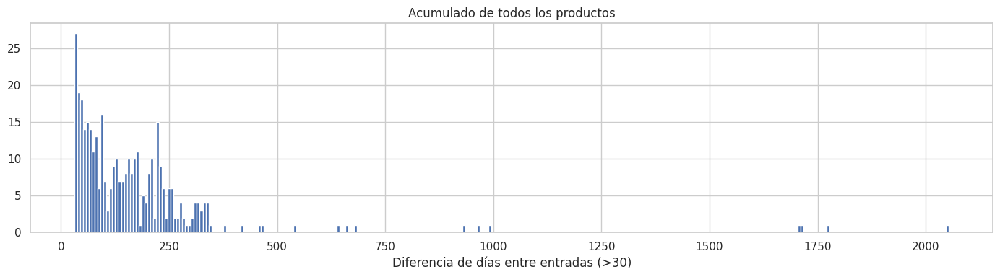

In [ ]:
# Distribución de intervalos global para intervalos grandes

lower_limit = 30
tmp_df = df_aux[df_aux['delta_dias'] > lower_limit]
#x = np.linspace(0, 2100, 11)
plt.figure(figsize=(14, 4))
plt.hist(tmp_df['delta_dias'],bins=300)
plt.title("Acumulado de todos los productos")
plt.xlabel(f"Diferencia de días entre entradas (>{lower_limit})")
#plt.xticks(x)
plt.tight_layout()
plt.show()

Quitamos los productos que tienen periodos faltantes más largos que un fuera de temporada estimado

In [ ]:
# asumiendo al menos 2 meses de temporada, fuera de temporada: 10x30 = 300
tmp_df = df_aux[df_aux['delta_dias'] > 300]
tmp_df.describe(include='all')

,Commodity,Date,Unit,Average,Type,delta_dias
count,37,37,37,37.000000,37,37.000000
unique,18,NaN,2,NaN,3,NaN
top,Guava,NaN,Kg,NaN,Fruit,NaN
freq,5,NaN,35,NaN,18,NaN
mean,NaN,2019-03-25 06:29:11.351351296,NaN,163.513514,NaN,581.189189
min,NaN,2015-03-09 00:00:00,NaN,32.500000,NaN,301.000000
25%,NaN,2017-12-18 00:00:00,NaN,57.500000,NaN,320.000000
50%,NaN,2019-09-21 00:00:00,NaN,115.000000,NaN,337.000000
75%,NaN,2020-10-21 00:00:00,NaN,225.000000,NaN,640.000000
max,NaN,2021-03-01 00:00:00,NaN,575.000000,NaN,2054.000000


In [ ]:
commodities_big_gap = tmp_df['Commodity'].unique()
commodities_big_gap

array(['Apple(Fuji)', 'Asparagus', 'Bauhania flower', 'Clive Dry',
       'Clive Green', 'Drumstick', 'Fish Fresh', 'Guava', 'Kinnow',
       'Lemon', 'Litchi(Local)', 'Papaya(Nepali)', 'Raddish Red',
       'Red Cabbbage', 'Sponge Gourd', 'Strawberry', 'Sugarcane',
       'Turnip'], dtype=object)

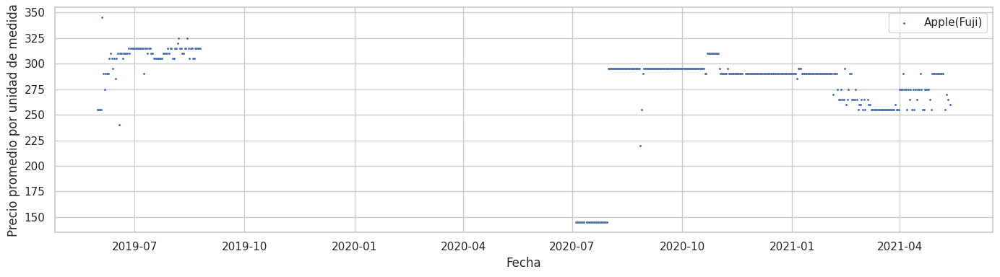

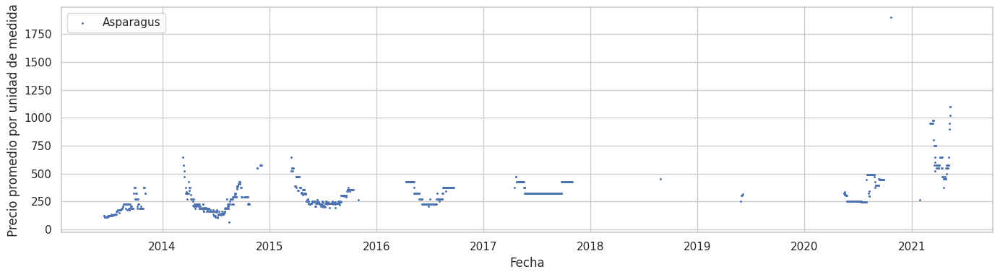

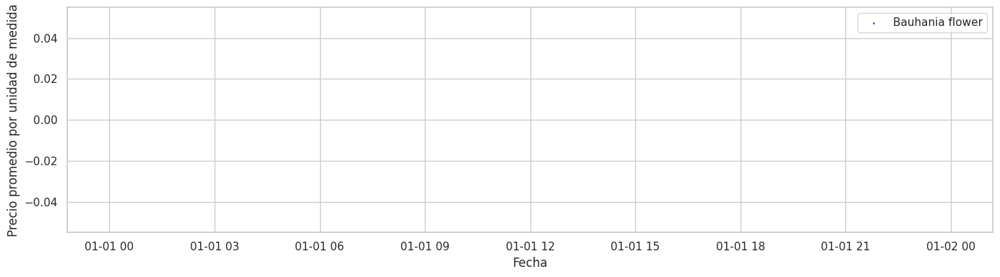

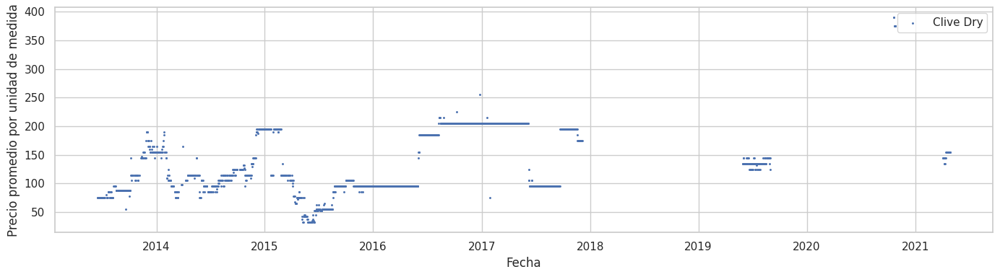

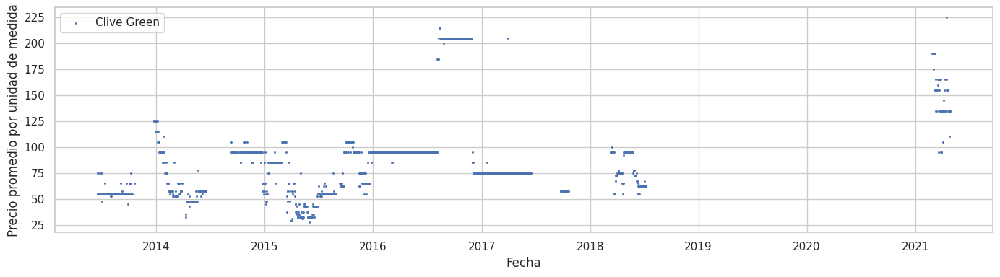

...

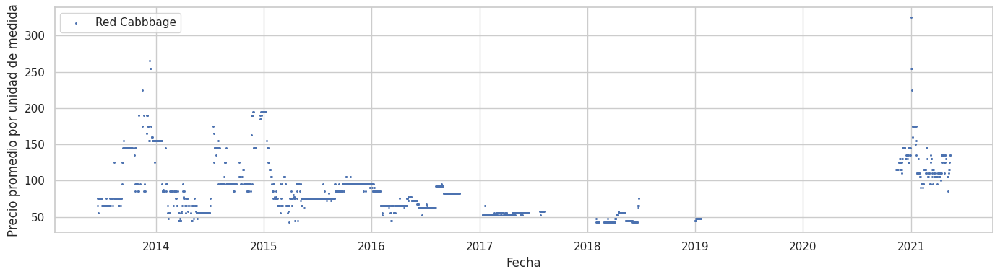

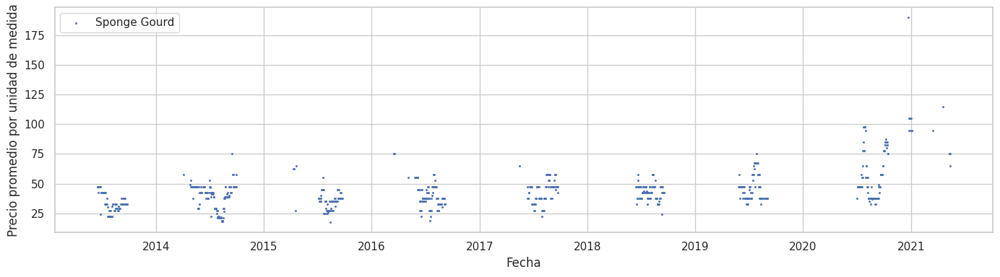

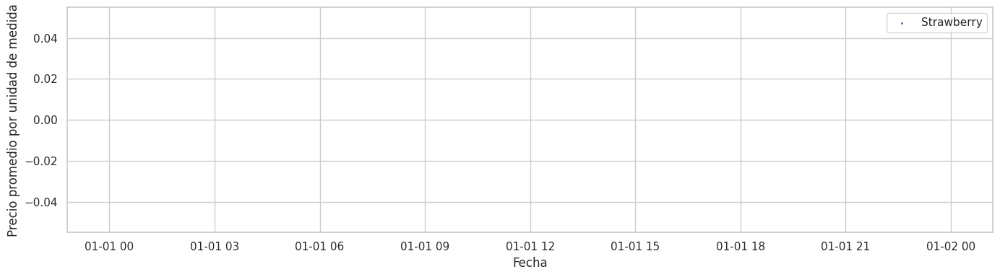

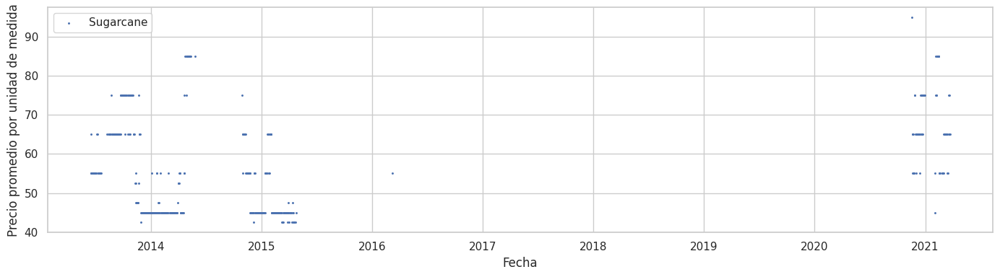

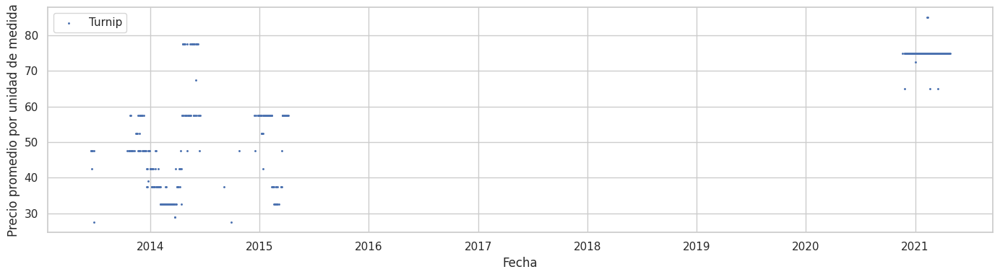

In [ ]:
# Revisamos las curvas
for commodity in commodities_big_gap:
    plt.figure(figsize=(14, 4))
    temp_df = df_vege_fruits[df_vege_fruits['Commodity'] == commodity]
    plt.scatter(temp_df['Date'], temp_df['Average'], label=commodity, marker='.', s=5)
    plt.legend()
    #plt.title("Evolución de precios promedios")
    plt.xlabel("Fecha")
    plt.ylabel("Precio promedio por unidad de medida")
    plt.tight_layout()
    plt.show()

In [ ]:
# Quitamos esos productos por tener series muy irregulares o con pocos datos hacia el final
df_vege_fruits = df_vege_fruits[~df_vege_fruits["Commodity"].isin(commodities_big_gap)]

# actualizamos intervalo medio por producto
df_aux = df_aux[~df_aux["Commodity"].isin(commodities_big_gap)]
intervalo_medio = df_aux.groupby("Commodity")["delta_dias"].mean()

df_vege_fruits['Commodity'].nunique()

101

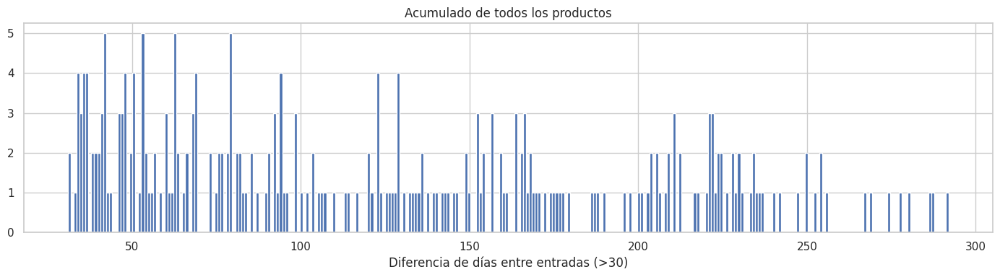

In [ ]:
# Volvemos a revisar la distribución de intervalos total

#lower_limit = 5
tmp_df = df_aux[df_aux['delta_dias'] > lower_limit]
#x = np.linspace(0, 2100, 11)
plt.figure(figsize=(14, 4))
plt.hist(tmp_df['delta_dias'],bins=300)
plt.title("Acumulado de todos los productos")
plt.xlabel(f"Diferencia de días entre entradas (>{lower_limit})")
#plt.xticks(x)
plt.tight_layout()
plt.show()

Identificamos los que tienen una frecuencia promedio menor a una entrada cada tres días

In [ ]:
# productos a revisar: 3 días < intervalo medio <= 7 días
productos_a_revisar = intervalo_medio[(3 < intervalo_medio) & (intervalo_medio <= 7)].index

# días promedio entre entradas
intervalo_medio[productos_a_revisar]

,delta_dias
Commodity,
Cauli Terai,3.167849
Mango(Maldah),3.263277
Sweet Potato,4.166667


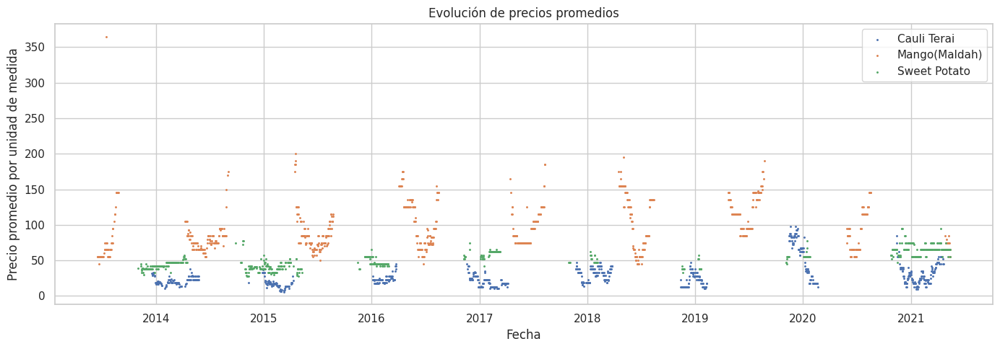

In [ ]:
# Las curvas no parecen mal así que no los quitamos

plt.figure(figsize=(14, 5))
for commodity in productos_a_revisar:
    temp_df = df_vege_fruits[df_vege_fruits['Commodity'] == commodity]
    plt.scatter(temp_df['Date'], temp_df['Average'], label=commodity, marker='.', s=5)

plt.legend()
plt.title("Evolución de precios promedios")
plt.xlabel("Fecha")
plt.ylabel("Precio promedio por unidad de medida")
plt.tight_layout()
plt.show()

Revisamos la cantidad de entradas que tiene cada producto en el último año

In [ ]:
N_days = 365

# calcular fecha de corte
fecha_max = df_vege_fruits["Date"].max()
fecha_corte = fecha_max - pd.Timedelta(days=N_days)

# filtrar últimos N_days días
df_ultimos_N_days = df_vege_fruits[df_vege_fruits["Date"] >= fecha_corte]

# contar entradas por producto
conteo_por_producto = df_ultimos_N_days.groupby("Commodity").size().reset_index(name="conteo")

pd.set_option('display.max_rows', None)
display(conteo_por_producto)
pd.reset_option('display.max_rows')

,Commodity,conteo
0,Apple(Jholey),334
1,Arum,263
2,Bakula,176
3,Bamboo Shoot,361
4,Banana,362
5,Barela,197
6,Bitter Gourd,361
7,Bottle Gourd,333
8,Brd Leaf Mustard,363
9,Brinjal Long,362


Quitamos los que tienen menos de 1 dato cada 3 días en el último año, dos años, tres años y cuatro años.

In [ ]:
days_in_year = 365

for i in [1,2,3,4]:
  # calcular fecha de corte
  N_days = i*days_in_year
  fecha_corte = fecha_max - pd.Timedelta(days=N_days)

  # filtrar últimos N_days días
  df_ultimos_N_days = df_vege_fruits[df_vege_fruits["Date"] >= fecha_corte]

  # contar entradas por producto
  conteo_por_producto = df_ultimos_N_days.groupby("Commodity").size().reset_index(name="conteo")

  # quitar los productos con pocas entradas el último periodo
  min_entries = 120*i
  commodities_no_resent_data = conteo_por_producto[conteo_por_producto['conteo'] < min_entries]['Commodity']
  df_vege_fruits = df_vege_fruits[~df_vege_fruits["Commodity"].isin(commodities_no_resent_data)]

df_vege_fruits['Commodity'].nunique()

82

In [ ]:
# Volvemos a revisar la cantidad de datos por producto
pd.set_option('display.max_rows', None)
display(df_vege_fruits['Commodity'].value_counts())
pd.reset_option('display.max_rows')

,count
Commodity,
Ginger,2751
Cauli Local,2750
Cabbage(Local),2749
Chilli Dry,2748
Raddish White(Local),2747
Potato Red,2746
Banana,2744
Bamboo Shoot,2744
Onion Dry (Indian),2742


##1.3 OUTLIERS
Exploramos los outliers según IQR. Como los modelos que vamos a usar son sensibles frente outliers usaremos STL, que cuenta con un método robusto ante outliers, para descomponer las series previamente. Los dejamos por el momento y retomamos para los productos en los que sea necesario.

In [ ]:
# Estadística descriptiva por producto
variables = ['Average'] #['Minimum', 'Maximum', 'Average']
df_vege_fruits.groupby('Commodity')[variables].describe()


Average                                            \
                       count        mean        std   min   25%    50%   
Commodity                                                                
Apple(Jholey)         2683.0  122.283824  36.720520  55.0  95.0  105.0   
Arum                  2020.0   42.602228   8.996921  11.0  37.5   42.5   
Bakula                1131.0   67.066313  23.557621  19.0  52.5   65.0   
Bamboo Shoot          2744.0  101.347485  27.540934  52.5  75.0  115.0   
Banana                2744.0   78.394133  20.639754  42.5  65.0   75.0   
...                      ...         ...        ...   ...   ...    ...   
Tomato Small(Local)   2741.0   38.185516  16.970949  10.0  25.0   35.0   
Tomato Small(Tunnel)   686.0   44.833819  21.274108  11.5  27.5   42.5   
Turnip A              2538.0   55.860323  16.650512  22.5  45.0   55.0   
Water Melon(Green)    2679.0   46.164427  14.457301  13.5  37.5   47.5   
Yam                   1105.0   43.600905  14.704348  19.0  31.0   42.5   

                                     
                         75%    max  
Commodity                            
Apple(Jholey)         125.00  290.0  
Arum                   47.50   67.5  
Bakula                 85.00  125.0  
Bamboo Shoot          125.00  305.0  
Banana                 95.00  525.0  
...                      ...    ...  
Tomato Small(Local)    47.50  117.5  
Tomato Small(Tunnel)   58.25  117.5  
Turnip A               65.00  145.0  
Water Melon(Green)     55.00  175.0  
Yam                    55.00  125.0  

[82 rows x 8 columns]

In [ ]:
# gráfico interactivo con dropdown de producto
fig = px.scatter(
    df_vege_fruits,
    x="Date",
    y="Average",
    color="Commodity",            # esto permite tener varios productos
    title="Evolución de precios por producto"
)

# para muchos productos mejor usar dropdown:
fig.update_layout(
    updatemenus=[
        {
            "buttons": [
                {
                    "method": "update",
                    "label": prod,
                    "args": [
                        {"visible": [p == prod for p in df_vege_fruits["Commodity"].unique()]},
                        {"title": f"Evolución de precios — {prod}"}
                    ],
                }
                for prod in df_vege_fruits["Commodity"].unique()
            ],
            "direction": "down",
        }
    ]
)

fig.show()

In [ ]:
# Ver cuántas combinaciones hay de Producto + Tipo + Unidad
df_vege_fruits.groupby(['Commodity', 'Type', 'Unit']).size().reset_index(name='count').head(20)

,Commodity,Type,Unit,count
0,Apple(Jholey),Fruit,Kg,2683
1,Arum,Vegetable,Kg,2020
2,Bakula,Fruit,Kg,1131
3,Bamboo Shoot,Vegetable,Kg,2744
4,Banana,Fruit,Doz,2744
5,Barela,Fruit,Kg,1390
6,Bitter Gourd,Vegetable,Kg,2670
7,Bottle Gourd,Vegetable,Kg,2700
8,Brd Leaf Mustard,Vegetable,Kg,2742
9,Brinjal Long,Vegetable,Kg,2736


In [ ]:
cant_verduras = 20 # Se mostraran solo esta cantidad para que el grafico sea legible

df_veg = df_vege_fruits[df_vege_fruits['Type'] == 'Vegetable']
top_veg = df_veg['Commodity'].value_counts().nlargest(cant_verduras).index

df_top_veg = df_veg[df_veg['Commodity'].isin(top_veg)]
#df_top_veg = df_veg   #Descomentar para mostrar Todas las verduras

fig = px.box(
    df_top_veg,
    x="Average",
    y="Commodity",
    color="Commodity",
    title="Distribución de Precios de Verduras",
    labels={"Average": "Precio Promedio", "Commodity": "Producto - Verduras"}
)
fig.show()

In [ ]:
df_fruit = df_vege_fruits[
    (df_vege_fruits['Type'] == 'Fruit') & (df_vege_fruits['Unit'] == 'Kg')
]

fig = px.box(
    df_fruit,
    x="Average",
    y="Commodity",
    facet_col="Unit",   # panel por unidad de medida
    color="Commodity",
    title="Distribución de Precios de Frutas",
    labels={"Average": "Precio Promedio", "Commodity": "Producto - Frutas"}
)
fig.show()

In [ ]:
df_fruit = df_vege_fruits[
(df_vege_fruits['Type'] == 'Fruit') & (df_vege_fruits['Unit'] != 'Kg')]

fig = px.box(
    df_fruit,
    x="Average",
    y="Commodity",
    facet_col="Unit",   # panel por unidad de medida
    color="Commodity",
    title="Distribución de Precios de Frutas",
    labels={"Average": "Precio Promedio", "Commodity": "Producto - Frutas"}
)
fig.show()

In [ ]:
df_other = df_vege_fruits[df_vege_fruits['Type'] == 'Other']

fig = px.box(
    df_other,
    x="Average",
    y="Commodity",
    color="Commodity",
    title="Distribución de Precios Otros ",
    labels={"Average": "Precio Promedio", "Commodity": "Producto - Otros"}
)
fig.show()

In [ ]:
# Identificación de OUTLIERS con IQR
def identify_outliers_iqr(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Filtrar outliers
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
    return outliers

In [ ]:
# Identificación de OUTLIERS con Z-Score
def identify_outliers_zscore(df,column):
    # función
    return 0

In [ ]:
# Identificación de OUTLIERS con IQR diferenciando por producto
outliers_by_comm = {}
columns = ['Average'] # ['Minimum', 'Maximum', 'Average']

for product in df_vege_fruits['Commodity'].unique():
    df_comm = df_vege_fruits[df_vege_fruits['Commodity'] == product]
    for col in columns:
        outliers_df = identify_outliers_iqr(df_comm, col)
        if not outliers_df.empty:
            outliers_by_comm[(product, col)] = outliers_df
            print(f"Outliers detectados en '{col}' para '{product}': {outliers_df.shape[0]}")
            # Opcional: mostrar algunos ejemplos
            #print(outliers_df[['Commodity','Type', 'Date', col]].head())

Outliers detectados en 'Average' para 'Apple(Jholey)': 368
Outliers detectados en 'Average' para 'Arum': 33
Outliers detectados en 'Average' para 'Bamboo Shoot': 1
Outliers detectados en 'Average' para 'Banana': 3
Outliers detectados en 'Average' para 'Barela': 18
Outliers detectados en 'Average' para 'Bitter Gourd': 21
Outliers detectados en 'Average' para 'Bottle Gourd': 16
Outliers detectados en 'Average' para 'Brd Leaf Mustard': 74
Outliers detectados en 'Average' para 'Brinjal Long': 82
Outliers detectados en 'Average' para 'Brinjal Round': 37
Outliers detectados en 'Average' para 'Brocauli': 56
Outliers detectados en 'Average' para 'Cabbage(Local)': 82
Outliers detectados en 'Average' para 'Capsicum': 46
Outliers detectados en 'Average' para 'Carrot(Local)': 4
Outliers detectados en 'Average' para 'Cauli Local': 16
Outliers detectados en 'Average' para 'Celery': 242
Outliers detectados en 'Average' para 'Chilli Dry': 3
Outliers detectados en 'Average' para 'Chilli Green': 61
Outl

##1.4 TRANSFORMACIÓN PARA MODELADO

Los modelos que vamos a usar sólo sirven para series estacionarias sin estacionalidad. Hay que quitarles las tendencias y la estacionalidad a las series previamente.

XGBoost: para que pueda tomar series temporales hay que estructurar los datos.

###Pruebas de estacionareidad ADF y KPSS:

ADF:   p < 0.05 → estacionaria.

KPSS:  p < 0.05 → NO estacionaria.

Para el mismo criterio de valor de p (0.05):

*   Caso 1: Ambos tests concluyen que la serie no es estacionaria → La serie no es estacionaria.

*   Caso 2: Ambos tests concluyen que la serie es estacionaria → La serie es estacionaria.

*   Caso 3: El test KPSS indica estacionariedad y el test ADF indica no estacionariedad → La serie es estacionaria en tendencia (trend stationary).
Debe eliminarse la tendencia para que la serie sea estrictamente estacionaria.
Luego se verifica la estacionariedad de la serie detrendida.

*   Caso 4: El test KPSS indica no estacionariedad y el test ADF indica estacionariedad → La serie es estacionaria en diferencias (difference stationary).
Debe aplicarse diferenciación para hacer la serie estacionaria.
Después se verifica la estacionariedad de la serie diferenciada.

In [ ]:
# Función para descomponer una serie: original = tendencia + estacional + residuo
def seasonality_LOESS(serie, period=None, robust=False):
    stl = STL(serie.dropna(), period=period)
    decomposition = stl.fit()

    var_resid = np.var(decomposition.resid)
    var_seasonal_resid = np.var(decomposition.resid + decomposition.seasonal)
    strength = max(0, 1 - var_resid/var_seasonal_resid)

    return decomposition, strength

In [ ]:
# Cargar los datos
df = df_vege_fruits.copy()
productos_seleccionados = df['Commodity'].unique().tolist()

In [ ]:
# Analizar tendencia y estacionalidad por producto
comportamiento = {}
for producto in productos_seleccionados:
    serie_producto = df[df['Commodity']==producto].set_index("Date")["Average"]

    # Descomposición tendencia+estacionalidad+residuo
    try:
        decomposition, strength = seasonality_LOESS(serie_producto, robust=True)
        print(f'STL auto-period for {producto}')
    except:
        decomposition, strength = seasonality_LOESS(serie_producto, robust=True, period=365)
        #print(f'STL period 365d for {producto}')

    # Estacionariedad antes y después de descomponer
    estacionariedad_ADF_prev_STL = adfuller(serie_producto.dropna())
    estacionariedad_ADF_post_STL = adfuller(decomposition.resid)
    estacionariedad_KPSS_prev_STL = kpss(serie_producto.dropna())
    estacionariedad_KPSS_post_STL = kpss(decomposition.resid)

    # Resultados
    comportamiento[producto] = {
        'decomposition': decomposition,
        'strength': strength,
        'adf_pvalue_before_stl': estacionariedad_ADF_prev_STL[1],
        'adf_pvalue_after_stl': estacionariedad_ADF_post_STL[1],
        'kpss_pvalue_before_stl': estacionariedad_KPSS_prev_STL[1],
        'kpss_pvalue_after_stl': estacionariedad_KPSS_post_STL[1]
    }

# Pasar el dict a DataFrame
df_comportamiento = pd.DataFrame.from_dict(comportamiento, orient="index")

# Resetear índice para que 'Commodity' quede como columna
df_comportamiento = df_comportamiento.reset_index().rename(columns={"index": "Commodity"})

# Filtrar solo las columnas de interés
df_comportamiento = df_comportamiento[[
    "Commodity",
    "strength",
    "adf_pvalue_before_stl",
    "adf_pvalue_after_stl",
    "kpss_pvalue_before_stl",
    "kpss_pvalue_after_stl"
]]

In [ ]:
# Estacionalidad
# strength ~ 1: fuerte estacionalidad
full_print=False
plot=False

# Identificar productos con estacionalidad
# El valor de strength fue elegido arbitrariamente: buscar algún criterio!
series_sin_estacionalidad = df_comportamiento[df_comportamiento['strength'] < 0.5]
series_con_estacionalidad = df_comportamiento[df_comportamiento['strength'] >= 0.5]
N_series_with_seas = series_con_estacionalidad['Commodity'].value_counts().sum()

print(f'Cantidad de series CON estacionalidad = {N_series_with_seas}')
if full_print:
    with pd.option_context('display.max_rows', None, 'display.max_columns', None):
        print(series_con_estacionalidad.sort_values(by='strength', ascending=False))
else:
    print(series_con_estacionalidad.sort_values(by='strength', ascending=False))

# Gráficos de las componentes de la serie (original=trend+seasonal+residual)
if plot:
    for producto in productos_seleccionados:
        decomposition = comportamiento[producto]['decomposition']
        strength = comportamiento[producto]['strength']
        adf_pvalue_before = comportamiento[producto]['avf_pvalue_before_stl']
        adf_pvalue_after = comportamiento[producto]['avf_pvalue_after_stl']
        kpss_pvalue_before = comportamiento[producto]['kpss_pvalue_before_stl']
        kpss_pvalue_after = comportamiento[producto]['kpss_pvalue_after_stl']

        print(f'\n{producto}: strength = {strength}')
        print(f'adf-p-before = {adf_pvalue_before}\t adf-p-after = {adf_pvalue_after}\t kpss-p-before = {kpss_pvalue_before}\t kpss-p-after = {kpss_pvalue_after}')
        decomposition.plot()
        plt.show()

Cantidad de series CON estacionalidad = 57
                Commodity  strength  adf_pvalue_before_stl  \
24       Cucumber(Hybrid)  1.000000           4.077109e-04   
32    French Bean(Hybrid)  1.000000           6.569068e-03   
28    Fish Fresh(Bachuwa)  1.000000           7.389426e-03   
30    Fish Fresh(Mungari)  1.000000           6.453124e-02   
29     Fish Fresh(Chhadi)  1.000000           1.580002e-03   
19   Chilli Green(Bullet)  1.000000           1.054622e-02   
31       Fish Fresh(Rahu)  1.000000           4.058206e-02   
54         Papaya(Indian)  1.000000           1.261462e-02   
46       Mushroom(Button)  1.000000           1.334470e-02   
60     Potato Red(Indian)  1.000000           5.129236e-01   
63  Raddish White(Hybrid)  1.000000           2.741531e-01   
78   Tomato Small(Tunnel)  1.000000           6.449744e-04   
70          Squash(Round)  1.000000           3.840038e-03   
59             Potato Red  0.827961           2.981682e-02   
14          Carrot(Local)  

In [ ]:
# Estacionariedad
# ADF   p < 0.05 → estacionaria.    p < 0.025 más conservador (más probabilidad de requerir transformación)
# KPSS  p < 0.05 → NO estacionaria. p < 0.075 más conservador (más probabilidad de requerir transformación)
full_print=False

# Identificar series NO estacionarias ANTES de la descomposición
series_adf_no_estacionarias_antes = df_comportamiento[df_comportamiento['adf_pvalue_before_stl'] >= 0.05]
N_series_adf_non_stat_before = series_adf_no_estacionarias_antes['Commodity'].value_counts().sum()
series_kpss_no_estacionarias_antes = df_comportamiento[df_comportamiento['kpss_pvalue_before_stl'] < 0.05]
N_series_kpss_non_stat_before = series_kpss_no_estacionarias_antes['Commodity'].value_counts().sum()

# Identificar series NO estacionarias DESPUÉS de la descomposición
series_adf_no_estacionarias_despues = df_comportamiento[df_comportamiento['adf_pvalue_after_stl'] >= 0.05]
N_series_adf_non_stat_after = series_adf_no_estacionarias_despues['Commodity'].value_counts().sum()
series_kpss_no_estacionarias_despues = df_comportamiento[df_comportamiento['kpss_pvalue_after_stl'] < 0.05]
N_series_kpss_non_stat_after = series_adf_no_estacionarias_despues['Commodity'].value_counts().sum()

# Imprimir resultados
print(f'Series NO estacionarias pre-STL = {N_series_adf_non_stat_before} (ADF)\t {N_series_kpss_non_stat_before} (KPSS)')
print(f'Series NO estacionarias pos-STL = {N_series_adf_non_stat_after} (ADF)\t {N_series_adf_non_stat_after} (KPSS)')
if full_print:
    with pd.option_context('display.max_rows', None, 'display.max_columns', None):
        print(series_adf_no_estacionarias_antes.sort_values(by='adf_pvalue_before_stl', ascending=False))
        print(series_kpss_no_estacionarias_antes.sort_values(by='kpss_pvalue_before_stl', ascending=False))
else:
    print(series_adf_no_estacionarias_antes.sort_values(by='adf_pvalue_before_stl', ascending=False))
    print(series_kpss_no_estacionarias_antes.sort_values(by='kpss_pvalue_before_stl', ascending=False))

Series NO estacionarias pre-STL = 12 (ADF)	 63 (KPSS)
Series NO estacionarias pos-STL = 0 (ADF)	 0 (KPSS)
                Commodity  strength  adf_pvalue_before_stl  \
74               Tamarind  0.478247               0.620966   
81                    Yam  0.780816               0.580052   
60     Potato Red(Indian)  1.000000               0.512924   
17             Chilli Dry  0.423788               0.348742   
63  Raddish White(Hybrid)  1.000000               0.274153   
75                   Tofu  0.360270               0.192829   
37                 Ginger  0.716001               0.161764   
40                Gundruk  0.466007               0.107636   
49                  Neuro  0.641102               0.105665   
35      Garlic Dry Nepali  0.629521               0.077863   
30    Fish Fresh(Mungari)  1.000000               0.064531   
56              Pineapple  0.508254               0.055414   

    adf_pvalue_after_stl  kpss_pvalue_before_stl  kpss_pvalue_after_stl  
74          2

Acá habría que transformar las series si hiciera falta hacerlas estacionarias luego de quitarles la tendencia y estacionalidad. Parece que no va a ser necesario porque todas las series transformadas (resid) son estacionarias a nivel de significancia 0.05.

Nota: KPSS sólo puede reportar p-valores menores a 0.1, mientras usemos nivel de significancia menor a eso estamos bien.

Ahora agregamos las tres descomposiciones al dataframe.

In [ ]:
rows = []
for producto in productos_seleccionados:
    serie_producto = df[df['Commodity']==producto].set_index("Date")["Average"]
    seasonal = comportamiento[producto]['decomposition'].seasonal
    trend = comportamiento[producto]['decomposition'].trend
    resid = comportamiento[producto]['decomposition'].resid

    tmp = pd.DataFrame({
        "Date": serie_producto.index,
        "Commodity": producto,
        "seasonal": seasonal.values,
        "trend": trend.values,
        "resid": resid.values
    })
    rows.append(tmp.reset_index(drop=True))

temp_df = pd.concat(rows, ignore_index=True)
temp_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 171061 entries, 0 to 171060
Data columns (total 5 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Date       171061 non-null  datetime64[ns]
 1   Commodity  171061 non-null  object        
 2   seasonal   171061 non-null  float64       
 3   trend      171061 non-null  float64       
 4   resid      171061 non-null  float64       
dtypes: datetime64[ns](1), float64(3), object(1)
memory usage: 6.5+ MB


In [ ]:
print(df[["Commodity","Date"]].duplicated().sum())        # debería ser 0
print(temp_df[["Commodity","Date"]].duplicated().sum())   # debería ser 0

0
0


In [ ]:
df_full = df.merge(
    temp_df,
    on=["Commodity", "Date"],
    how="left" #"inner", usar "left" si querés conservar todas las filas de df
)

In [ ]:
df_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 171061 entries, 0 to 171060
Data columns (total 8 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Commodity  171061 non-null  object        
 1   Date       171061 non-null  datetime64[ns]
 2   Unit       171061 non-null  object        
 3   Average    171061 non-null  float64       
 4   Type       171061 non-null  object        
 5   seasonal   171061 non-null  float64       
 6   trend      171061 non-null  float64       
 7   resid      171061 non-null  float64       
dtypes: datetime64[ns](1), float64(4), object(3)
memory usage: 10.4+ MB


In [ ]:
# gráfico interactivo con dropdown de producto
fig = px.scatter(
    df_full,
    x="Date",
    y="resid",
    color="Commodity",            # esto permite tener varios productos
    title="Evolución de residuos por producto"
)

# para muchos productos mejor usar dropdown:
fig.update_layout(
    updatemenus=[
        {
            "buttons": [
                {
                    "method": "update",
                    "label": prod,
                    "args": [
                        {"visible": [p == prod for p in df_vege_fruits["Commodity"].unique()]},
                        {"title": f"Evolución de residuos — {prod}"}
                    ],
                }
                for prod in df_full["Commodity"].unique()
            ],
            "direction": "down",
        }
    ]
)

fig.show()

In [ ]:
# Función que adapta la base de datos para poder usar modelos de ML no
# específicos de series temporales
def estructurar_datos(data, target, lags=[1, 2, 3, 7, 14, 30], low_cat_feat=None):
    df_feat = data.copy()

    # El modelo no maneja fechas, derivamos variables numéricas
    # para mayor sensibilidad a estacionalidades
    df_feat["dayofyear"] = df_feat["Date"].dt.dayofyear
    df_feat["dayofweek"] = df_feat["Date"].dt.dayofweek
    df_feat["month"] = df_feat["Date"].dt.month
    df_feat["year"] = df_feat["Date"].dt.year

    # One-hot encoding para categóricas de poco rango que potencialmente
    # puedan aportar al entrenamiento
    if low_cat_feat is not None:
        for ft in low_cat_feat:
            df_feat = pd.get_dummies(df_feat, columns=[ft], drop_first=True)
            print(f'\'{ft}\' one-hot encoded')

    # Target encoding para productos así los tiene en cuenta
    mean_prices = df_feat.groupby("Commodity")[target].mean()
    df_feat["Commodity_t_encoded"] = df_feat["Commodity"].map(mean_prices)
    print('\'Commodity\' mean-encoded into \'Commodity_t_encoded\'')

    # Normalización para estabilizar escalas
    stats = df_feat.groupby("Commodity")[target].agg(["mean", "std"])
    df_feat = df_feat.merge(stats, on="Commodity")
    df_feat[target+"_norm"] = (df_feat[target] - df_feat["mean"]) / df_feat["std"]
    print(f'\'{target}\' normalized into \'{target}_norm\'')

    # Se agregan variables con corrimiento y medias móviles
    # que le dan estructura secuencial a los datos.
    for lag in lags:
        df_feat[f"lag_{lag}"] = df_feat.groupby("Commodity")[target+"_norm"].shift(lag)
        print(f'Added lag_{lag}')

        df_feat[f"roll_mean_{lag}"] = (
            df_feat.groupby("Commodity")[target+"_norm"]
            .shift(1)
            .rolling(window=lag)
            .mean()
        )
        print(f'Added roll_mean_{lag}')

    df_feat = df_feat.dropna()

    return df_feat

In [ ]:
# Crear las features
df_feat = estructurar_datos(
    df_full,
    'resid',
    low_cat_feat=['Unit','Type']
)

df_feat.info()

'Unit' one-hot encoded
'Type' one-hot encoded
'Commodity' mean-encoded into 'Commodity_t_encoded'
'resid' normalized into 'resid_norm'
Added lag_1
Added roll_mean_1
Added lag_2
Added roll_mean_2
Added lag_3
Added roll_mean_3
Added lag_7
Added roll_mean_7
Added lag_14
Added roll_mean_14
Added lag_30
Added roll_mean_30
<class 'pandas.core.frame.DataFrame'>
Index: 168601 entries, 30 to 171060
Data columns (total 30 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   Commodity            168601 non-null  object        
 1   Date                 168601 non-null  datetime64[ns]
 2   Average              168601 non-null  float64       
 3   seasonal             168601 non-null  float64       
 4   trend                168601 non-null  float64       
 5   resid                168601 non-null  float64       
 6   dayofyear            168601 non-null  int32         
 7   dayofweek            168601 non-null  int32    

In [ ]:
# gráfico interactivo con dropdown de producto
fig = px.scatter(
    df_feat,
    x="Date",
    y="resid_norm",
    color="Commodity",            # esto permite tener varios productos
    title="Evolución de residuos normalizados por producto"
)

# para muchos productos mejor usar dropdown:
fig.update_layout(
    updatemenus=[
        {
            "buttons": [
                {
                    "method": "update",
                    "label": prod,
                    "args": [
                        {"visible": [p == prod for p in df_vege_fruits["Commodity"].unique()]},
                        {"title": f"Evolución de residuos normalizados — {prod}"}
                    ],
                }
                for prod in df_full["Commodity"].unique()
            ],
            "direction": "down",
        }
    ]
)

fig.show()

#2. MODELOS
1. XGBoost Global
2. XGBoost por producto

Consideraciones:
* Hacer entrenamiento y validación por expanding window con X_train_valid / y_train_valid.

* Evaluación con X_test / y_test.

* Siempre invertir las transformaciones antes de calcular métricas interpretables (RMSE, MAE, MAPE, R²): desnormalizar usando mean y std (df_feat) y agregarles tendencia y estacionalidad (trend y seasonal en df_feat) . Para series con ceros o valores muy pequeños, usar sMAPE en lugar de MAPE. Combinar métricas es lo ideal:

  * RMSE → magnitud del error
  * MAPE/sMAPE → error relativo
  * MFE → sesgo del modelo

Opcional: En la validación y evaluación se puede usar 'Average' como y_true para el cálculo de los errores y así alcanza con sólo invertir las transformaciones de y_pred. Se tomaría de df_feat y haría falta repetir los splits.

In [ ]:
# Separar en entrenamiento+validación y evaluación (últimos 12 meses)
fecha_corte = df_feat["Date"].max() - pd.DateOffset(months=12)

train_valid = df_feat[df_feat["Date"] < fecha_corte]
test = df_feat[df_feat["Date"] >= fecha_corte]

# Separar variables explicativas de variable objetivo
X_train_valid = train_valid.drop(columns=["Average","resid","resid_norm","trend","seasonal","mean","std"])
y_train_valid = train_valid[["Commodity", "resid_norm"]]

X_test = test.drop(columns=["Average","resid","resid_norm","trend","seasonal","mean","std"])
y_test = test[["Commodity","resid_norm"]]

In [ ]:
# Funciones auxiliares
def f_smape(y_true, y_pred):
    """Symmetric Mean Absolute Percentage Error"""
    return np.mean(2 * np.abs(y_pred - y_true) / (np.abs(y_pred) + np.abs(y_true) + 1e-8)) * 100

def f_mfe(y_true, y_pred):
    """Mean Forecast Error (sesgo)"""
    return np.mean(y_pred - y_true)

def invertir_transformaciones(y_pred, df_ref):
    """Invertir desnormalización y sumar tendencia + estacionalidad"""
    y_pred_1d = np.array(y_pred).ravel()  # Asegura vector 1D
    y_inv = (y_pred_1d * df_ref["std"].values) + df_ref["mean"].values
    y_inv += df_ref["trend"].values + df_ref["seasonal"].values
    return y_inv

def mape_condicional(y_true, y_pred, umbral_min=1.0):
    """
    Calcula MAPE o sMAPE según el umbral mínimo de valor real.
    Si algún valor < umbral_min -> sMAPE, sino MAPE
    """
    if np.any(y_true < umbral_min):
        return f_smape(y_true, y_pred)  # sMAPE
    else:
        return mean_absolute_percentage_error(y_true, y_pred) # np.mean(np.abs((y_pred - y_true) / y_true)) * 100  # MAPE

##2.1 XGBoost Global

In [ ]:
# OPTIMIZACIÓN DE HIPERPARÁMETROS (Optuna + TimeSeriesSplit)

X = X_train_valid.drop(columns=["Commodity","Date"])
y = y_train_valid.drop(columns=["Commodity"])

N_FOLDS = 7
N_TRIALS = 30

def objective(trial):
    params = {
        "n_estimators": trial.suggest_int("n_estimators", 300, 700),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.2, log=True),
        "max_depth": trial.suggest_int("max_depth", 3, 10),
        "subsample": trial.suggest_float("subsample", 0.7, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.7, 1.0),
        "min_child_weight": trial.suggest_int("min_child_weight", 1, 10),
        "gamma": trial.suggest_float("gamma", 0, 5),
        "random_state": 42,
        "n_jobs": -1,
        "objective": "reg:squarederror",
        "eval_metric": "rmse"
    }

    tscv = TimeSeriesSplit(n_splits=N_FOLDS)
    scores = []

    for train_idx, valid_idx in tscv.split(X):
        X_train, X_valid = X.iloc[train_idx], X.iloc[valid_idx]
        y_train, y_valid = y.iloc[train_idx], y.iloc[valid_idx]

        model = xgb.XGBRegressor(**params)
        model.fit(X_train, y_train, eval_set=[(X_valid, y_valid)], verbose=False)

        y_pred = model.predict(X_valid)
        rmse = np.sqrt(mean_squared_error(y_valid, y_pred))
        scores.append(rmse)

    return np.mean(scores)

print("Buscando hiperparámetros óptimos con Optuna...")
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=N_TRIALS)

best_params = study.best_params
print(f"\n Mejores parámetros: {best_params}")
print(f"RMSE medio en validación: {study.best_value:.4f}")

[I 2025-10-06 00:15:16,525] A new study created in memory with name: no-name-584b07d8-7e5d-46c0-849f-bf015ed58e01


Buscando hiperparámetros óptimos con Optuna...


[I 2025-10-06 00:15:41,455] Trial 0 finished with value: 0.508800021909668 and parameters: {'n_estimators': 530, 'learning_rate': 0.1900575089460969, 'max_depth': 9, 'subsample': 0.7255367252887187, 'colsample_bytree': 0.8656330726172171, 'min_child_weight': 8, 'gamma': 4.636884695845639}. Best is trial 0 with value: 0.508800021909668.
[I 2025-10-06 00:16:17,480] Trial 1 finished with value: 0.5137970727447977 and parameters: {'n_estimators': 623, 'learning_rate': 0.0511326111523415, 'max_depth': 9, 'subsample': 0.9031135086361867, 'colsample_bytree': 0.8623495875034147, 'min_child_weight': 2, 'gamma': 2.385824730495253}. Best is trial 0 with value: 0.508800021909668.
[I 2025-10-06 00:16:53,087] Trial 2 finished with value: 0.5077939248089152 and parameters: {'n_estimators': 651, 'learning_rate': 0.02195366707747073, 'max_depth': 3, 'subsample': 0.7713630687578662, 'colsample_bytree': 0.8486913320332966, 'min_child_weight': 10, 'gamma': 0.4424935117335105}. Best is trial 2 with value: 


 Mejores parámetros: {'n_estimators': 581, 'learning_rate': 0.011383355166476636, 'max_depth': 5, 'subsample': 0.7065117476853352, 'colsample_bytree': 0.9950369068698338, 'min_child_weight': 9, 'gamma': 0.16874160006639627}
RMSE medio en validación: 0.5055


In [ ]:
# ENTRENAMIENTO FINAL CON LOS MEJORES PARÁMETROS
model_final = xgb.XGBRegressor(**best_params)
model_final.fit(X, y)

# Guardar modelo global
joblib.dump(model_final, "xgb_model_global_opt.pkl")

['xgb_model_global_opt.pkl']

In [ ]:
# EVALUACIÓN EN TEST
X_test_model = X_test.drop(columns=["Commodity","Date"])
y_pred_test = model_final.predict(X_test_model)

# Invertir transformaciones a escala original
y_pred_inv = invertir_transformaciones(y_pred_test, test)
y_true_inv = invertir_transformaciones(y_test.drop(columns="Commodity"), test)

In [ ]:
# MÉTRICAS GLOBALES
rmse_global = np.sqrt(mean_squared_error(y_true_inv, y_pred_inv))
mape_global = mape_condicional(y_true_inv, y_pred_inv)
r2_global = r2_score(y_true_inv, y_pred_inv)
mfe_global = f_mfe(y_true_inv, y_pred_inv)

print("\n===== Desempeño Global en Test =====")
print(f"RMSE: {rmse_global:.3f}")
print(f"MAPE/sMAPE: {mape_global:.3f}")
print(f"R²: {r2_global:.3f}")
print(f"MFE: {mfe_global:.3f}")


===== Desempeño Global en Test =====
RMSE: 6.282
MAPE/sMAPE: 0.038
R²: 0.994
MFE: 0.066


In [ ]:
# MÉTRICAS POR PRODUCTO
df_eval = test.copy()
df_eval["y_true_inv"] = y_true_inv
df_eval["y_pred_inv"] = y_pred_inv

metricas_prod = []
for prod, grp in df_eval.groupby("Commodity"):
    rmse = np.sqrt(mean_squared_error(grp["y_true_inv"], grp["y_pred_inv"]))
    mape = mape_condicional(grp["y_true_inv"], grp["y_pred_inv"])
    r2 = r2_score(grp["y_true_inv"], grp["y_pred_inv"])
    mfe = f_mfe(grp["y_true_inv"], grp["y_pred_inv"])
    metricas_prod.append({"Commodity": prod, "RMSE": rmse, "MAPE/sMAPE": mape, "R2": r2, "MFE": mfe})

df_metricas_prod = pd.DataFrame(metricas_prod)

# Top y Bottom 10 por RMSE
top10_rmse = df_metricas_prod.sort_values("RMSE").head(10)
bottom10_rmse = df_metricas_prod.sort_values("RMSE").tail(10)

print("\n===== 🔝 TOP 10 productos con mejor desempeño (RMSE) =====")
print(top10_rmse)

print("\n===== 🔻 BOTTOM 10 productos con peor desempeño (RMSE) =====")
print(bottom10_rmse)

print("\n==================================================================")

# Top y Bottom 10 por MAPE/sMAPE
top10_rmse = df_metricas_prod.sort_values("MAPE/sMAPE").head(10)
bottom10_rmse = df_metricas_prod.sort_values("MAPE/sMAPE").tail(10)

print("\n===== 🔝 TOP 10 productos con mejor desempeño (MAPE/sMAPE) =====")
print(top10_rmse)

print("\n===== 🔻 BOTTOM 10 productos con peor desempeño (MAPE/sMAPE) =====")
print(bottom10_rmse)

print("\n==================================================================")

# Top y Bottom 10 por R2
top10_rmse = df_metricas_prod.sort_values("R2").tail(10)
bottom10_rmse = df_metricas_prod.sort_values("R2").head(10)

print("\n===== 🔝 TOP 10 productos con mejor desempeño (R2) =====")
print(top10_rmse)

print("\n===== 🔻 BOTTOM 10 productos con peor desempeño (R2) =====")
print(bottom10_rmse)


===== 🔝 TOP 10 productos con mejor desempeño (RMSE) =====
                Commodity          RMSE    MAPE/sMAPE   R2           MFE
63  Raddish White(Hybrid)  2.348802e-14  7.266484e-16  1.0 -1.616235e-15
24       Cucumber(Hybrid)  2.709134e-14  8.919681e-16  1.0 -2.135987e-15
60     Potato Red(Indian)  3.289374e-14  6.172067e-16  1.0 -1.943471e-15
70          Squash(Round)  3.494985e-14  7.689125e-16  1.0 -5.501990e-16
78   Tomato Small(Tunnel)  3.875116e-14  8.707940e-16  1.0  2.609338e-16
32    French Bean(Hybrid)  5.494460e-14  8.274095e-16  1.0 -1.031776e-15
19   Chilli Green(Bullet)  5.768521e-14  8.237060e-16  1.0  1.374163e-15
54         Papaya(Indian)  7.510797e-14  6.659194e-16  1.0 -3.675221e-16
29     Fish Fresh(Chhadi)  1.573663e-13  5.830491e-16  1.0 -8.638817e-15
30    Fish Fresh(Mungari)  1.661264e-13  5.406746e-16  1.0 -7.625337e-15

===== 🔻 BOTTOM 10 productos con peor desempeño (RMSE) =====
             Commodity       RMSE  MAPE/sMAPE        R2       MFE
16         

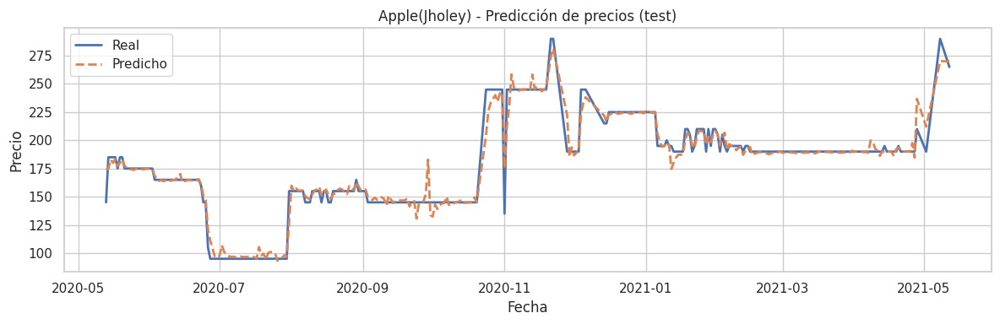

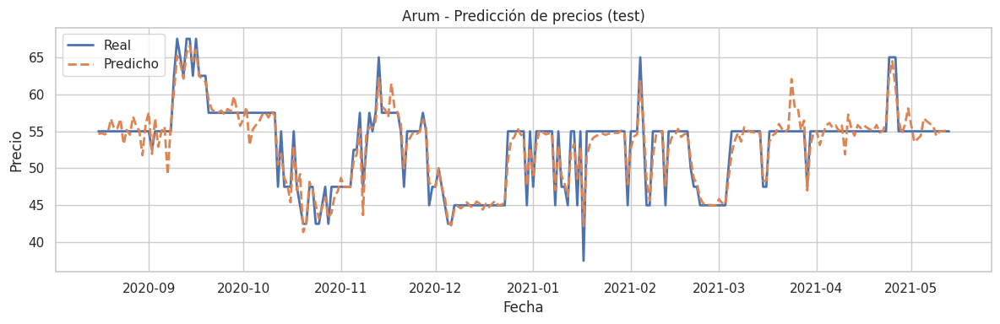

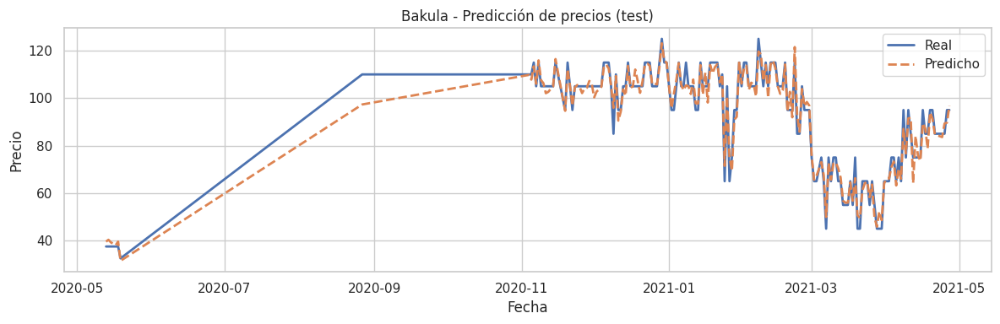

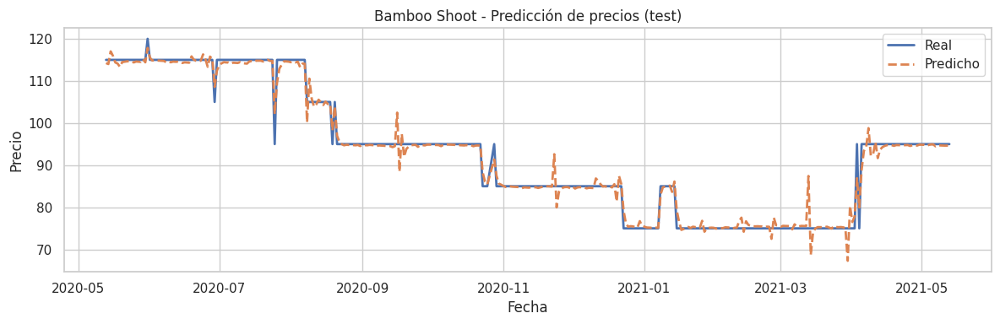

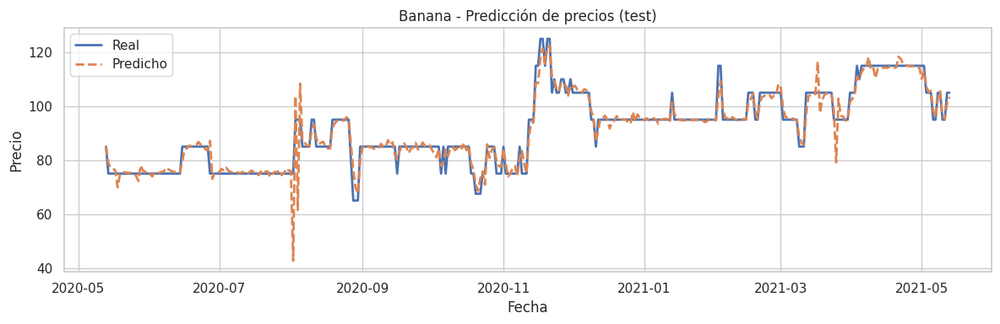

...

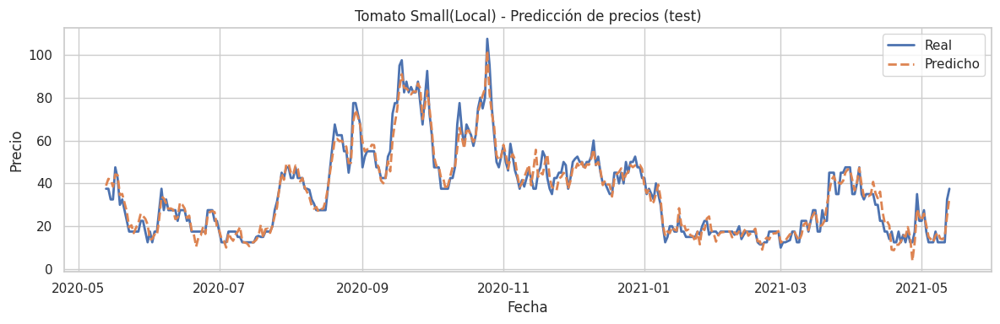

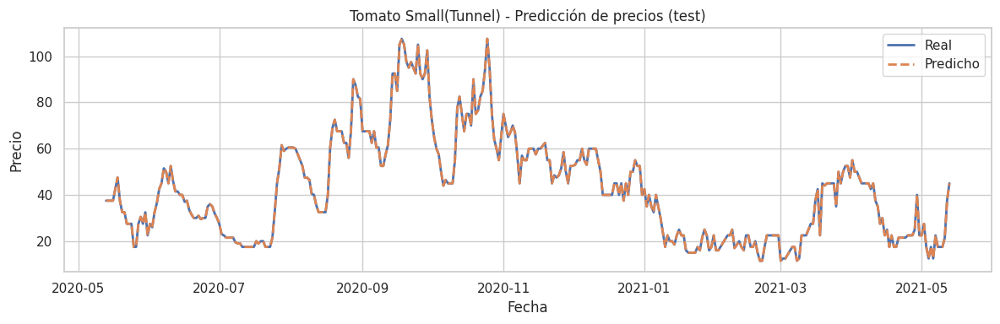

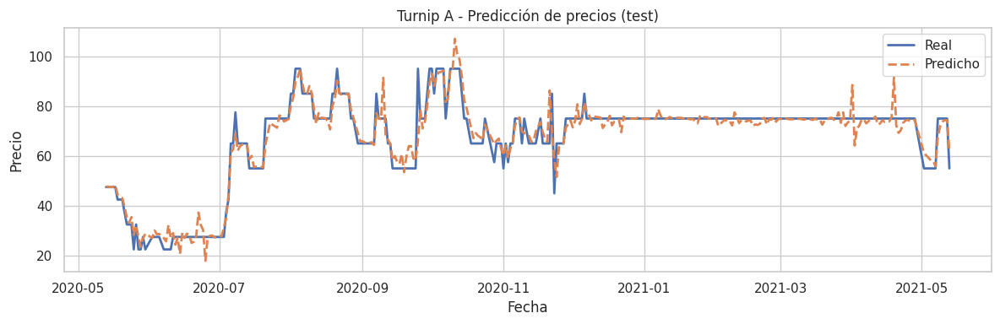

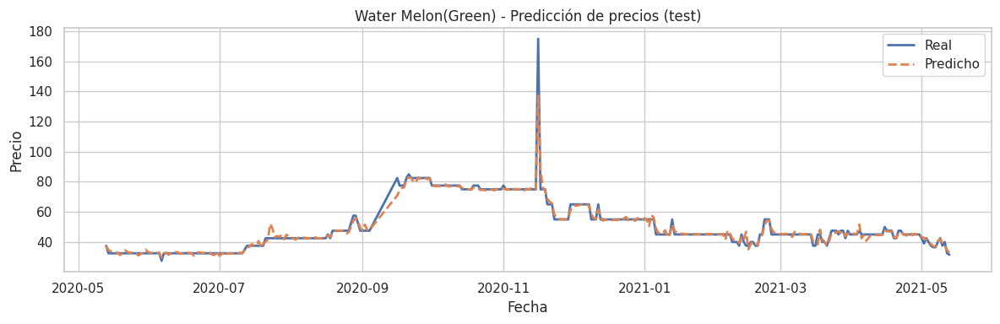

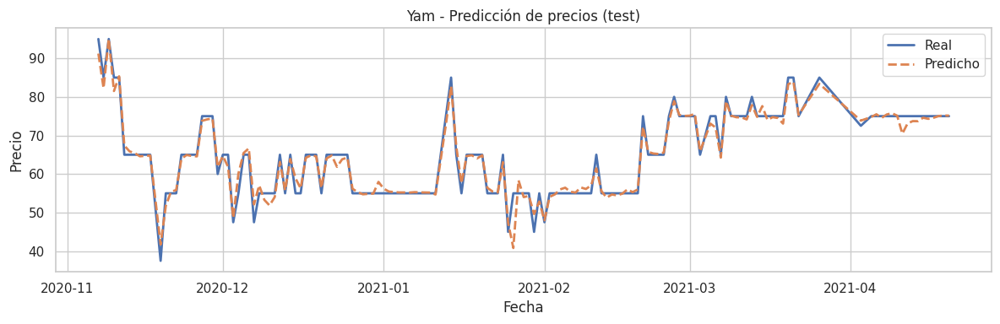

In [ ]:
# GRÁFICOS DE SERIES REALES VS PREDICHAS
productos = df_eval["Commodity"].unique()
for prod in productos:
    df_p = df_eval[df_eval["Commodity"] == prod]
    plt.figure(figsize=(12, 4))
    plt.plot(df_p["Date"], df_p["y_true_inv"], label="Real", lw=2)
    plt.plot(df_p["Date"], df_p["y_pred_inv"], label="Predicho", lw=2, linestyle="--")
    plt.title(f"{prod} - Predicción de precios (test)")
    plt.xlabel("Fecha")
    plt.ylabel("Precio")
    plt.legend()
    plt.tight_layout()
    plt.show()

##2.2 XGBoost por producto

In [ ]:
# ==========================================
# 1. PARÁMETROS
# ==========================================
N_FOLDS = 7
UMBRAL_MIN = 1.0  # umbral para usar sMAPE
resultados = {}

# ==========================================
# 2. LOOP POR PRODUCTO
# ==========================================
for producto in sorted(X_train_valid["Commodity"].unique()):
    print(f"\n🔹 Entrenando modelo para: {producto}")

    # Filtrar datos del producto
    X_t_v = X_train_valid[X_train_valid["Commodity"] == producto].copy()
    y_t_v = y_train_valid[y_train_valid["Commodity"] == producto].copy()

    X_t_v = X_t_v.drop(columns=["Date", "Commodity"])
    y_t_v = y_t_v.drop(columns=["Commodity"])

    # Validación temporal tipo expanding window
    tscv = TimeSeriesSplit(n_splits=N_FOLDS)
    fold_metrics = []

    for fold, (train_idx, valid_idx) in enumerate(tscv.split(X_t_v)):
        X_train, X_valid = X_t_v.iloc[train_idx], X_t_v.iloc[valid_idx]
        y_train, y_valid = y_t_v.iloc[train_idx], y_t_v.iloc[valid_idx]

        # Modelo XGBoost compatible con Colab
        model = xgb.XGBRegressor(
            n_estimators=400,
            learning_rate=0.05,
            max_depth=6,
            subsample=0.8,
            colsample_bytree=0.8,
            objective="reg:squarederror",
            random_state=42,
            n_jobs=-1,
            #early_stopping_rounds=30, # removed early stopping rounds
            eval_metric="rmse"
        )

        # Entrenamiento
        model.fit(
            X_train, y_train,
            eval_set=[(X_valid, y_valid)],
            verbose=False
        )

        # Predicción
        y_pred = model.predict(X_valid)

        # Invertir transformaciones a precio real
        df_ref = train_valid[train_valid["Commodity"] == producto].iloc[valid_idx]
        y_true_inv = invertir_transformaciones(y_valid.values, df_ref)
        y_pred_inv = invertir_transformaciones(y_pred, df_ref)

        # Métricas por fold
        rmse = np.sqrt(mean_squared_error(y_true_inv, y_pred_inv))
        r2 = r2_score(y_true_inv, y_pred_inv)
        bias = f_mfe(y_true_inv, y_pred_inv)
        error_rel = mape_condicional(y_true_inv, y_pred_inv, UMBRAL_MIN)

        fold_metrics.append({
            "fold": fold,
            "RMSE": rmse,
            "R2": r2,
            "MFE": bias,
            "MAPE/sMAPE": error_rel
        })

        print(f"  Fold {fold}: RMSE={rmse:.2f}, MAPE/sMAPE={error_rel:.2f}, R2={r2:.2f}")

    # Entrenamiento final sobre todo train_valid
    model_final = xgb.XGBRegressor(
        n_estimators=400,
        learning_rate=0.05,
        max_depth=6,
        subsample=0.8,
        colsample_bytree=0.8,
        objective="reg:squarederror",
        random_state=42,
        n_jobs=-1,
        eval_metric="rmse"
    )
    model_final.fit(X_t_v, y_t_v)

    # Evaluación final sobre test
    X_test_prod = X_test[X_test["Commodity"] == producto].drop(columns=["Date", "Commodity"])
    y_test_prod = y_test[y_test["Commodity"] == producto]["resid_norm"]

    y_pred_test = model_final.predict(X_test_prod)
    df_test_ref = test[test["Commodity"] == producto]

    y_true_inv_test = invertir_transformaciones(y_test_prod.values, df_test_ref)
    y_pred_inv_test = invertir_transformaciones(y_pred_test, df_test_ref)

    rmse_test = np.sqrt(mean_squared_error(y_true_inv_test, y_pred_inv_test))
    r2_test = r2_score(y_true_inv_test, y_pred_inv_test)
    bias_test = f_mfe(y_true_inv_test, y_pred_inv_test)
    error_test = mape_condicional(y_true_inv_test, y_pred_inv_test, UMBRAL_MIN)

    # Guardar métricas y modelo
    df_folds = pd.DataFrame(fold_metrics)
    resultados[producto] = {
        "val_RMSE": df_folds["RMSE"].mean(),
        "val_MAPE/sMAPE": df_folds["MAPE/sMAPE"].mean(),
        "test_RMSE": rmse_test,
        "test_MAPE/sMAPE": error_test,
        "test_MFE": bias_test,
        "test_R2": r2_test,
        "modelo": model_final
    }

    # Guardar modelo individual
    joblib.dump(model_final, f"xgb_model_{producto.replace('/', '_')}.pkl")

# ==========================================
# Resumen final
# ==========================================

df_resultados = pd.DataFrame([
    {"Producto": k, **v} for k, v in resultados.items()
])


🔹 Entrenando modelo para: Apple(Jholey)
  Fold 0: RMSE=8.49, MAPE/sMAPE=0.04, R2=0.88
  Fold 1: RMSE=18.79, MAPE/sMAPE=0.12, R2=-0.15
  Fold 2: RMSE=7.40, MAPE/sMAPE=0.04, R2=0.69
  Fold 3: RMSE=3.82, MAPE/sMAPE=0.03, R2=0.74
  Fold 4: RMSE=4.22, MAPE/sMAPE=0.03, R2=0.51
  Fold 5: RMSE=7.60, MAPE/sMAPE=0.04, R2=0.82
  Fold 6: RMSE=10.81, MAPE/sMAPE=0.05, R2=0.93

🔹 Entrenando modelo para: Arum
  Fold 0: RMSE=2.66, MAPE/sMAPE=0.05, R2=0.77
  Fold 1: RMSE=3.34, MAPE/sMAPE=0.09, R2=0.68
  Fold 2: RMSE=4.37, MAPE/sMAPE=0.08, R2=0.43
  Fold 3: RMSE=4.04, MAPE/sMAPE=0.07, R2=0.78
  Fold 4: RMSE=2.56, MAPE/sMAPE=0.04, R2=0.80
  Fold 5: RMSE=3.57, MAPE/sMAPE=0.06, R2=0.75
  Fold 6: RMSE=2.24, MAPE/sMAPE=0.03, R2=0.75

🔹 Entrenando modelo para: Bakula
  Fold 0: RMSE=3.79, MAPE/sMAPE=0.07, R2=0.94
  Fold 1: RMSE=4.00, MAPE/sMAPE=0.06, R2=0.93
  Fold 2: RMSE=11.67, MAPE/sMAPE=0.13, R2=0.25
  Fold 3: RMSE=7.42, MAPE/sMAPE=0.07, R2=0.79
  Fold 4: RMSE=7.70, MAPE/sMAPE=0.08, R2=0.71
  Fold 5: RMSE=

In [ ]:
df_short_results = df_resultados.drop(columns=["val_RMSE","val_MAPE/sMAPE","modelo"])

# Top y Bottom 10 por RMSE
top10_rmse = df_short_results.sort_values("test_RMSE").head(10)
bottom10_rmse = df_short_results.sort_values("test_RMSE").tail(10)

print("\n===== 🔝 TOP 10 productos con mejor desempeño (RMSE) =====")
print(top10_rmse)

print("\n===== 🔻 BOTTOM 10 productos con peor desempeño (RMSE) =====")
print(bottom10_rmse)

print("\n==================================================================")

# Top y Bottom 10 por MAPE/sMAPE
top10_rmse = df_short_results.sort_values("test_MAPE/sMAPE").head(10)
bottom10_rmse = df_short_results.sort_values("test_MAPE/sMAPE").tail(10)

print("\n===== 🔝 TOP 10 productos con mejor desempeño (MAPE/sMAPE) =====")
print(top10_rmse)

print("\n===== 🔻 BOTTOM 10 productos con peor desempeño (MAPE/sMAPE) =====")
print(bottom10_rmse)

print("\n==================================================================")

# Top y Bottom 10 por R2
top10_rmse = df_short_results.sort_values("test_R2").tail(10)
bottom10_rmse = df_short_results.sort_values("test_R2").head(10)

print("\n===== 🔝 TOP 10 productos con mejor desempeño (R2) =====")
print(top10_rmse)

print("\n===== 🔻 BOTTOM 10 productos con peor desempeño (R2) =====")
print(bottom10_rmse)


===== 🔝 TOP 10 productos con mejor desempeño (RMSE) =====
                 Producto     test_RMSE  test_MAPE/sMAPE      test_MFE  \
63  Raddish White(Hybrid)  2.634915e-14     7.910052e-16 -5.549239e-15   
24       Cucumber(Hybrid)  3.383571e-14     1.094955e-15 -6.086474e-15   
60     Potato Red(Indian)  3.553209e-14     6.697079e-16 -4.877245e-15   
70          Squash(Round)  4.553630e-14     1.041000e-15 -1.235066e-14   
78   Tomato Small(Tunnel)  4.655484e-14     1.127863e-15  7.080338e-15   
32    French Bean(Hybrid)  7.139146e-14     1.077291e-15 -1.979521e-14   
19   Chilli Green(Bullet)  9.423046e-14     1.385357e-15  6.325618e-14   
54         Papaya(Indian)  9.443329e-14     8.959014e-16 -3.389371e-15   
29     Fish Fresh(Chhadi)  1.919293e-13     7.069088e-16 -4.328048e-14   
28    Fish Fresh(Bachuwa)  2.002804e-13     7.244001e-16  4.405797e-15   

    test_R2  
63      1.0  
24      1.0  
60      1.0  
70      1.0  
78      1.0  
32      1.0  
19      1.0  
54      1.0  


Productos con MAPE/sMAPE < 5.0%: ['Apple(Jholey)', 'Arum', 'Bakula', 'Bamboo Shoot', 'Banana', 'Barela', 'Bitter Gourd', 'Bottle Gourd', 'Brd Leaf Mustard', 'Brinjal Long', 'Brinjal Round', 'Brocauli', 'Cabbage(Local)', 'Capsicum', 'Carrot(Local)', 'Cauli Local', 'Celery', 'Chilli Dry', 'Chilli Green', 'Chilli Green(Bullet)', 'Christophine', 'Coriander Green', 'Cow pea(Long)', 'Cress Leaf', 'Cucumber(Hybrid)', 'Cucumber(Local)', 'Fennel Leaf', 'Fenugreek Leaf', 'Fish Fresh(Bachuwa)', 'Fish Fresh(Chhadi)', 'Fish Fresh(Mungari)', 'Fish Fresh(Rahu)', 'French Bean(Hybrid)', 'French Bean(Local)', 'Garlic Dry Chinese', 'Garlic Dry Nepali', 'Garlic Green', 'Ginger', 'Grapes(Green)', 'Green Peas', 'Gundruk', 'Jack Fruit', 'Lettuce', 'Lime', 'Mint', 'Mombin', 'Mushroom(Button)', 'Mushroom(Kanya)', 'Mustard Leaf', 'Neuro', 'Okara', 'Onion Dry (Indian)', 'Onion Green', 'Orange(Nepali)', 'Papaya(Indian)', 'Parseley', 'Pineapple', 'Pointed Gourd(Local)', 'Pomegranate', 'Potato Red', 'Potato Red(Ind

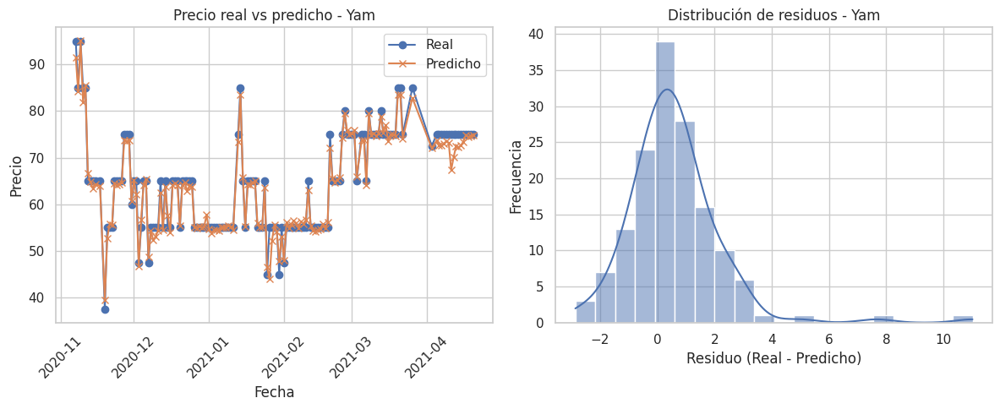

In [ ]:
# Umbral de MAPE/sMAPE
UMBRAL_MAPE = 5.0

# Filtrar products that meet the condition
productos_filtrados = [p for p, r in resultados.items() if r["test_MAPE/sMAPE"] < UMBRAL_MAPE]

print(f"Productos con MAPE/sMAPE < {UMBRAL_MAPE}%: {productos_filtrados}")

# Loop para graficar
for producto_graf in productos_filtrados:
    df_test_ref = test[test["Commodity"] == producto_graf]
    X_test_prod = X_test[X_test["Commodity"] == producto_graf].drop(columns=["Date","Commodity"])

    y_true = invertir_transformaciones(
        y_test[y_test["Commodity"] == producto_graf]["resid_norm"].values,
        df_test_ref
    )
    y_pred = invertir_transformaciones(
        resultados[producto_graf]["modelo"].predict(X_test_prod),
        df_test_ref
    )

    residuos = y_true - y_pred


# Crear figura
plt.figure(figsize=(12,5))

# Precio real vs predicho
plt.subplot(1,2,1)
plt.plot(df_test_ref["Date"], y_true, label="Real", marker='o')
plt.plot(df_test_ref["Date"], y_pred, label="Predicho", marker='x')
plt.title(f"Precio real vs predicho - {producto_graf}")
plt.xlabel("Fecha")
plt.ylabel("Precio")
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)

# Residuos
plt.subplot(1,2,2)
sns.histplot(residuos, bins=20, kde=True)
plt.title(f"Distribución de residuos - {producto_graf}")
plt.xlabel("Residuo (Real - Predicho)")
plt.ylabel("Frecuencia")
plt.grid(True)

plt.tight_layout()
plt.show()

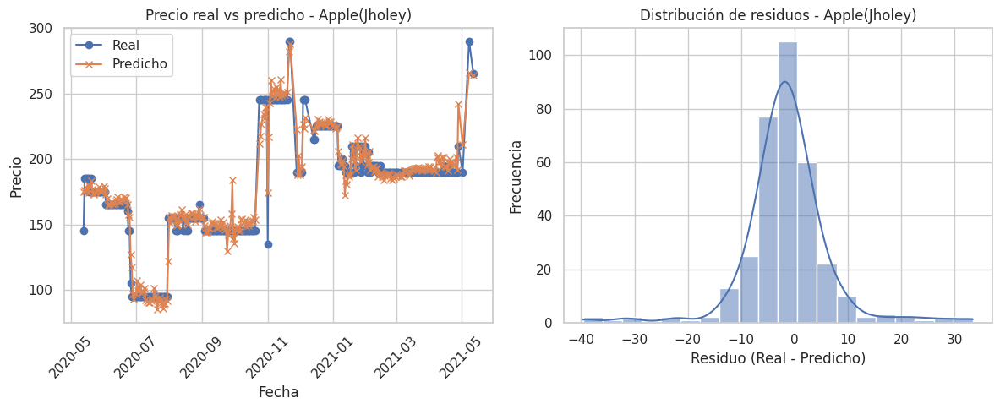

In [ ]:

#Graficos

# Producto que queremos graficar
producto_graf = "Apple(Jholey)"

# Extraer resultados del test
df_test_ref = test[test["Commodity"] == producto_graf]
y_true = invertir_transformaciones(y_test[y_test["Commodity"] == producto_graf]["resid_norm"].values, df_test_ref)
y_pred = invertir_transformaciones(resultados[producto_graf]["modelo"].predict(
    X_test[X_test["Commodity"] == producto_graf].drop(columns=["Date", "Commodity"])
), df_test_ref)

# Crear figura
plt.figure(figsize=(12,5))

# 1️⃣ Precio real vs predicho
plt.subplot(1,2,1)
plt.plot(df_test_ref["Date"], y_true, label="Real", marker='o')
plt.plot(df_test_ref["Date"], y_pred, label="Predicho", marker='x')
plt.title(f"Precio real vs predicho - {producto_graf}")
plt.xlabel("Fecha")
plt.ylabel("Precio")
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)

# 2️⃣ Residuos
plt.subplot(1,2,2)
residuos = y_true - y_pred
sns.histplot(residuos, bins=20, kde=True)
plt.title(f"Distribución de residuos - {producto_graf}")
plt.xlabel("Residuo (Real - Predicho)")
plt.ylabel("Frecuencia")
plt.grid(True)

plt.tight_layout()
plt.show()


In [ ]:
# Seleccionar los 10 productos con menor error en test
top_10 = df_resultados.sort_values("test_MAPE/sMAPE").head(10)["Producto"].tolist()

# Graficar cada uno
plt.figure(figsize=(6,3))
for producto in top_10:
    res = resultados[producto]
    modelo = res["modelo"]

    # Recuperar datos de test para ese producto
    data_p = df_feat[df_feat["Commodity"] == producto].copy().dropna()
    split_test = int(len(data_p) * 0.9)
    X_test = data_p.drop(columns=["Date", "Commodity", "Average", "Average_norm"]).iloc[split_test:]
    df_ref = data_p.iloc[split_test:]

    # Predicciones
    y_pred = modelo.predict(X_test)

    # Invertir transformaciones
    y_true = invertir_transformaciones(df_ref["Average_norm"], df_ref)
    y_pred_inv = invertir_transformaciones(y_pred, df_ref)

    # Gráfico
    plt.figure(figsize=(6,3))
    plt.plot(df_ref["Date"], y_true, label="Precio Real", color="black", linewidth=2)
    plt.plot(df_ref["Date"], y_pred_inv, label="Predicción XGBoost", color="tomato", linewidth=2, alpha=0.8)
    plt.title(f"Evolución del Precio - {producto}\n(MAPE/sMAPE: {res['test_MAPE/sMAPE']:.2f}%)", fontsize=8)
    plt.xlabel("Fecha", fontsize=6)
    plt.ylabel("Precio Promedio", fontsize=6)
    plt.legend(fontsize=6)
    plt.grid(True, linestyle="--", alpha=0.5)
    plt.show()


KeyError: "['Average_norm'] not found in axis"

<Figure size 600x300 with 0 Axes>